<a href="https://colab.research.google.com/github/fcolombo7/AN2DL-2020/blob/main/Intro-with-pred.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# AN2DL - Image classification challenge

In [ ]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd

Configuration and constants

In [ ]:
SEED = 1234
tf.random.set_seed(SEED)  

IMG_H, IMG_W = (256, 256) #IMAGE HEIGHT, IMAGE WIDTH
BS = 64 #BATCH SIZE

VALIDATION_SPLIT = 0.2
DATA_AUGMENTATION = True

## Data import and preprocessing

#### Import the *MaskDataset*

In [ ]:
# Get current working directory
cwd = os.getcwd()
print(cwd)

/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

drive_root_folder = '/content/drive/My Drive/ANN_project/'

Mounted at /content/drive


Check if the dataset has been already processed, otherwise unzip it.

**N.B.**: we are unzipping in the `/content` folder and not in `drive`.  
If you want to unzip in your drive folder, write `os.chdir(drive_root_folder)`



In [ ]:
#check if the dataset is already available
if not os.path.exists(cwd+'/MaskDataset'):
  !unzip '/content/drive/My Drive/ANN_project/artificial-neural-networks-and-deep-learning-2020.zip'
else:
  print('MaskDataset already loaded')

#### Data preprocessing

##### Check dataset image *size* using `PIL`

In [ ]:
import pathlib
path = os.path.join(cwd, 'MaskDataset') 
data_dir = pathlib.Path(path)
training_images = list(data_dir.glob('training/*'))

In [ ]:
print(f"number of images: {len(training_images)}")

number of images: 5614


In [ ]:
import PIL

image_sizes = set() #unique sizes
for image in training_images:
  image_sizes.add(PIL.Image.open(str(image)).size)
print(f"number of unique sizes: {len(image_sizes)}")

number of unique sizes: 275


In [ ]:
#explore some of them
size_iter = iter(image_sizes)
for i in range(15):
  print(i, next(size_iter))

0 (612, 423)
1 (612, 508)
2 (427, 612)
3 (612, 326)
4 (345, 612)
5 (612, 552)
6 (612, 434)
7 (612, 463)
8 (434, 612)
9 (612, 397)
10 (612, 566)
11 (612, 408)
12 (612, 469)
13 (612, 354)
14 (463, 612)


##### Set up the `ImageDataGenerator` and split the dataset 

Definition of the `ImageDataGenerator` for _data augmentation_:

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create training ImageDataGenerator object
if DATA_AUGMENTATION:
    train_data_gen = ImageDataGenerator(rotation_range=10,
                                        width_shift_range=10,
                                        height_shift_range=10,
                                        zoom_range=0.3,
                                        horizontal_flip=True,
                                        brightness_range = [0.7, 1.35],
                                        channel_shift_range=0.2,
                                        fill_mode='nearest',
                                        rescale=1./255,
                                        validation_split=VALIDATION_SPLIT)
else:
    train_data_gen = ImageDataGenerator(rescale=1./255,
                                        validation_split=VALIDATION_SPLIT)

Define the *train* and *validation* dataset through the `pandas` library:

In [ ]:
import json

dataset_dir = os.path.join(cwd, "MaskDataset")
training_dir = os.path.join(dataset_dir, "training")
with open(os.path.join(dataset_dir,"train_gt.json")) as f:
  dic = json.load(f)
  dataframe = pd.DataFrame(dic.items())
  dataframe.rename(columns = {0:'filename', 1:'class'}, inplace = True)
  dataframe = dataframe.sample(frac=1, random_state=SEED)
  dataframe["class"] = dataframe["class"].astype('string')
  train_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=BS,
                                               target_size=(IMG_H, IMG_W),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'training')
  
  validation_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=BS,
                                               target_size=(IMG_H, IMG_W),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'validation')

Found 4492 validated image filenames belonging to 3 classes.
Found 1122 validated image filenames belonging to 3 classes.


##### Train images exploration

In [ ]:
visualize = False

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'None')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'All')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

Text(0.5, 1.0, 'Some')

([], <a list of 0 Text major ticklabel objects>)

([], <a list of 0 Text major ticklabel objects>)

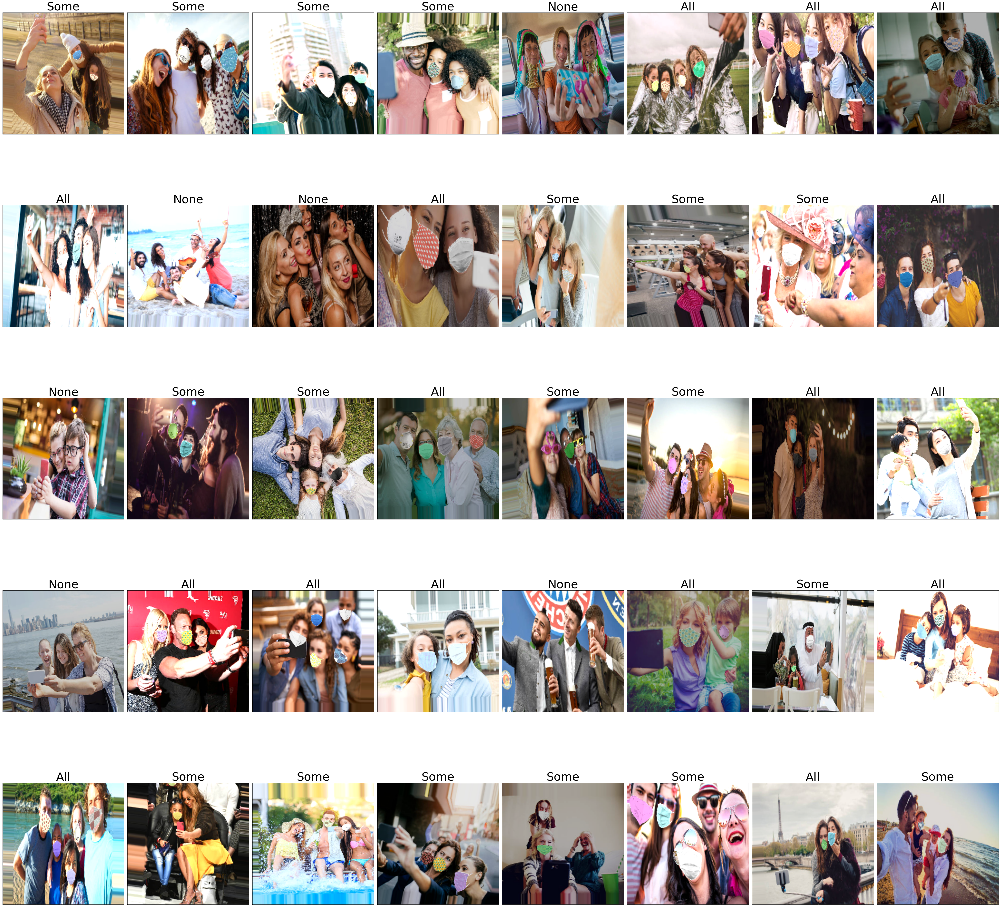

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

if visualize:
  x_batch, y_batch = next(train_gen)

  classes = np.array(["None", "All", "Some"])

  axes=[]
  fig=plt.figure(figsize=(60, 60))

  for i in range(5*8):
    img = x_batch[i]
    axes.append( fig.add_subplot(5, 8, i+1) )
    subplot_title=(classes[y_batch[i].nonzero()][0])
    axes[-1].set_title(subplot_title, fontsize=50)  
    plt.xticks([])
    plt.yticks([])
    plt.grid=False
    plt.imshow(img)
  fig.tight_layout()    
  plt.show();

Check the split distributions 

In [ ]:
check = True

In [ ]:
if check:  
  valid_iterator = iter(validation_gen)
  valid_class_count = np.array([0, 0, 0])
  for i in range(len(valid_iterator)):
    valid_img_s , lab_s = next(valid_iterator)
    for lab in lab_s:
      valid_class_count[lab.nonzero()[0]] = valid_class_count[lab.nonzero()[0]] +1
  print(valid_class_count)
  """
  train_iterator = iter(train_gen)
  train_class_count = np.array([0, 0, 0])
  for i in range(len(train_iterator)):
    train_img_s , lab_s = next(train_iterator)
    for lab in lab_s:
      train_class_count[lab.nonzero()[0]] = train_class_count[lab.nonzero()[0]] +1
  print(train_class_count)
  """

[383 402 337]


'\n  train_iterator = iter(train_gen)\n  train_class_count = np.array([0, 0, 0])\n  for i in range(len(train_iterator)):\n    train_img_s , lab_s = next(train_iterator)\n    for lab in lab_s:\n      train_class_count[lab.nonzero()[0]] = train_class_count[lab.nonzero()[0]] +1\n  print(train_class_count)\n  '

#### Dobbiamo aggiungere una sezione su `Test Set Exploration`?

## Model

In [ ]:
num_classes = len(train_gen.class_indices)
num_classes

3

In [ ]:
#create the dataset objects
train_ds = tf.data.Dataset.from_generator(lambda: train_gen, 
                                          output_types=(tf.float32, tf.float32),
                                          output_shapes= ([None, IMG_H, IMG_W, 3], [None, num_classes]))
train_ds
train_ds = train_ds.repeat()

valid_ds = tf.data.Dataset.from_generator(lambda: validation_gen,
                                          output_types = (tf.float32, tf.float32),
                                          output_shapes = ([None, IMG_H, IMG_W, 3], [None, num_classes]))
valid_ds
valid_ds = valid_ds.repeat()

<FlatMapDataset shapes: ((None, 256, 256, 3), (None, 3)), types: (tf.float32, tf.float32)>

<FlatMapDataset shapes: ((None, 256, 256, 3), (None, 3)), types: (tf.float32, tf.float32)>

Feature extraction

In [ ]:
def get_feature_extraction(start_f=8, depth=6, conv_per_depth = 1, activation='relu', kernel_size = 3, stride = (1, 1)):
  # Architecture: Features extraction -> Classifier
  model = tf.keras.Sequential()

  # Features extraction
  for i in range(depth):

      if i == 0:
          input_shape = [IMG_H, IMG_W, 3]
      else:
          input_shape=[None]

      # Conv block: Conv2D -> Activation -> Pooling
      for n in range(conv_per_depth):
        model.add(tf.keras.layers.Conv2D(filters=start_f, 
                                        kernel_size=(kernel_size, kernel_size),
                                        strides=stride,
                                        padding='same',
                                        input_shape=input_shape,
                                        activation = activation))
      model.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

      start_f *= 2

  return model

Classifier

In [ ]:
def get_classifier(model, hidden_layer=3, units=512, dropout=0.2, regularization=0.001, activation='relu'):
  model.add(tf.keras.layers.Flatten())
  if dropout and regularization:
    for i in range(hidden_layer):
      model.add(tf.keras.layers.Dense(units=units, activation=activation, kernel_regularizer=tf.keras.regularizers.l2(regularization)))
      model.add(tf.keras.layers.Dropout(dropout))
  elif dropout:
    for i in range(hidden_layer):
      model.add(tf.keras.layers.Dense(units=units, activation=activation))
      model.add(tf.keras.layers.Dropout(dropout))
  elif regularization:
    for i in range(hidden_layer):
      model.add(tf.keras.layers.Dense(units=units, activation=activation, kernel_regularizer=tf.keras.regularizers.l2(regularization)))
  else:
    for i in range(hidden_layer):
      model.add(tf.keras.layers.Dense(units=units, activation=activation))

  model.add(tf.keras.layers.Dense(units=num_classes, activation='softmax'))
  return model

In [ ]:
model = get_feature_extraction(depth = 4, stride = (2,2))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 128, 128, 8)       224       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 64, 8)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 16)        1168      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 16, 16, 16)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 32)          4640      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 4, 4, 32)          0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 2, 2, 64)          1

In [ ]:
model = get_classifier(model, hidden_layer=2, units=128, regularization=0.001)
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 128, 128, 8)       224       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 64, 8)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 16)        1168      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 16, 16, 16)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 32)          4640      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 4, 4, 32)          0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 2, 2, 64)          1

### Compile the model

In [ ]:
def get_optimizer(lr_schedule = 1e-3):
  return tf.keras.optimizers.Adam(learning_rate=lr_schedule)

In [ ]:
model.compile(optimizer=get_optimizer(),
              loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/My\ Drive/ANN_project/classification_result/

<IPython.core.display.Javascript object>

### Train the model

In [ ]:
from datetime import datetime
def get_callbacks(name, es=True):
  obj = []

  exps_dir = os.path.join(drive_root_folder,'classification_result')
  if not os.path.exists(exps_dir):
    os.mkdir(exps_dir)

  now = datetime.now().strftime('%b%d_%H-%M-%S')
  temp_dir = name + '_' + now

  #Model Checkpoints
  ckpt_dir = os.path.join(exps_dir, temp_dir, 'ckpts')
  if not os.path.exists(ckpt_dir):
    os.makedirs(ckpt_dir)

  obj.append(tf.keras.callbacks.ModelCheckpoint(filepath = os.path.join(ckpt_dir, 'cp_{epoch:02d}.ckpt'),
                                                save_weights_only = True,
                                                save_best_only = True))
  
  #Tensor board logs
  tb_dir = os.path.join(exps_dir, temp_dir + '/tb_logs')
  if not os.path.exists(tb_dir):
    os.makedirs(tb_dir)
  obj.append(tf.keras.callbacks.TensorBoard(log_dir=tb_dir,
                                            profile_batch = 0,
                                            histogram_freq = 1))
  if es:
    obj.append(tf.keras.callbacks.EarlyStopping(monitor = 'val_loss', patience = 10))

  return obj

In [ ]:
start_fit = True

In [ ]:
if start_fit:
  name = 'CNN2_test'
  model.fit(x=train_ds,
            epochs=100,  #### set repeat in training dataset
            steps_per_epoch=len(train_gen),
            validation_data=valid_ds,
            validation_steps=len(validation_gen), 
            callbacks=get_callbacks(name),
            verbose = 1)

Epoch 1/100
71/71 [==============================] - 397s 6s/step - loss: 57026.4766 - accuracy: 0.3326 - val_loss: 196.3012 - val_accuracy: 0.3021
Epoch 2/100
71/71 [==============================] - 396s 6s/step - loss: 189.6950 - accuracy: 0.3310 - val_loss: 183.6563 - val_accuracy: 0.3387
Epoch 3/100
71/71 [==============================] - 395s 6s/step - loss: 179.1463 - accuracy: 0.3370 - val_loss: 174.8148 - val_accuracy: 0.3592
Epoch 4/100
71/71 [==============================] - 398s 6s/step - loss: 171.2677 - accuracy: 0.3250 - val_loss: 167.7503 - val_accuracy: 0.3021
Epoch 5/100
71/71 [==============================] - 399s 6s/step - loss: 164.7135 - accuracy: 0.3353 - val_loss: 161.6613 - val_accuracy: 0.3592
Epoch 6/100
71/71 [==============================] - 401s 6s/step - loss: 158.9799 - accuracy: 0.3370 - val_loss: 156.2500 - val_accuracy: 0.3387
Epoch 7/100
71/71 [==============================] - ETA: 0s - loss: 153.8111 - accuracy: 0.3195

### Load the best model according to the checkpoints

In [ ]:
model_to_load = 'CNN2_DropOut_L2_Nov11_10-18-46'
ckpt_path = os.path.join(drive_root_folder,'classification_result',model_to_load, 'ckpts','cp_87.ckpt')
model.load_weights(ckpt_path)

Check the validation loss: 

In [ ]:
evaluation = model.evaluate(x=valid_ds, 
                            batch_size=BS,
                            steps = len(validation_gen),
                            verbose = 1)
evaluation

## Prediction



```
from PIL import Image
# ....

image_filenames = next(os.walk('../Classification_Dataset/test))[2]

results = {}
for image_name in image_filenames:

   img = Image.open('.../test/img_name').convert('RGB')
   img_array = np.array(img)
   img_array = np.expand_dims(img_array, 0) 
   ....
   data_normalization...
   ....
   prediction = argmax(softmax)   # predicted class
   .....
   results[image_name] = prediction```



First load the test images:

In [ ]:
import pathlib
path = os.path.join(os.getcwd(),'MaskDataset', 'test')
data_dir = pathlib.Path(path)

test_image_filenames = list(data_dir.glob('*.jpg'))

In [ ]:
len(test_image_filenames)

In [ ]:
make_prediction_now = True

In [ ]:
def make_prediction():
  results = {}
  results_expanded = {}
  for test_image in test_image_filenames:
    img = tf.keras.preprocessing.image.load_img(test_image, target_size=(IMG_H, IMG_W))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0) # Create a batch
    predictions = model.predict(img_array)
    tf.keras.preprocessing.image.
    results_expanded[os.path.basename(test_image)]=predictions
    results[os.path.basename(test_image)]=np.argmax(predictions)
  return results, results_expanded

In [ ]:
def create_csv(results, results_dir):
    csv_fname = 'results_'
    csv_fname += datetime.now().strftime('%b%d_%H-%M-%S') + '.csv'

    with open(os.path.join(results_dir, csv_fname), 'w') as f:
        f.write('Id,Category\n')
        for key, value in results.items():
            f.write(key + ',' + str(value) + '\n')

In [ ]:
if make_prediction_now:
  create_csv(make_prediction()[0], drive_root_folder)